# Multimedia Project --
## Retrieving Frames

In [1]:
from perceptual.filterbank import *

import cv2
import numpy as np
import pandas as pd
import colorsys
import matplotlib.pyplot as plt

# determine what OpenCV version we are using
try:
    import cv2.cv as cv
    USE_CV2 = True
except ImportError:
    # OpenCV 3.x does not have cv2.cv submodule
    USE_CV2 = False
    
import sys
from skimage import color
from skimage import io
from cvtools import ipynb_show_cv2_image
from cvtools import ipynb_show_matrix


In [2]:
def yiq_to_rgb_new(y, i, q):
    r = y + 0.948262*i + 0.624013*q
    g = y - 0.276066*i - 0.639810*q
    b = y - 1.105450*i + 1.729860*q

    return (r, g, b)

In [4]:
import datetime
from cvtools import ipynb_show_cv2_image
from cvtools import VideoReader

vidFname = 'nba.mp4'

video_reader = VideoReader()

video_reader.open(vidFname)


# Video duration (in seconds).
video_duration = float(
    video_reader.get_number_of_frames()) / float(video_reader.get_frame_rate())

print('resolution: %d x %d' % (video_reader.get_width(), video_reader.get_height()))
print('number of frames: %d' % video_reader.get_number_of_frames())
print('duration: %s' % datetime.timedelta(seconds=video_duration))


resolution: 852 x 480
number of frames: 49485
duration: 0:27:29.546460


29.999155


/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


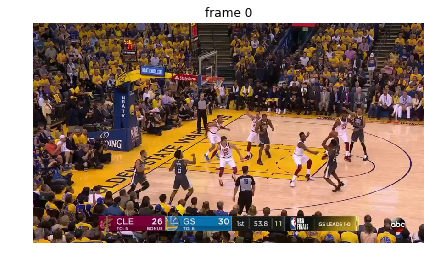

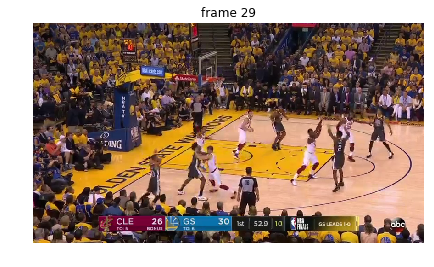

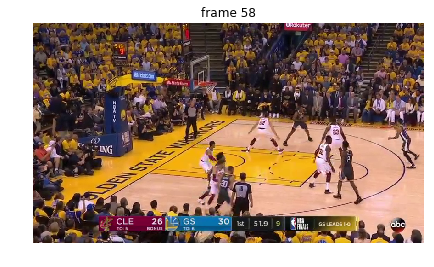

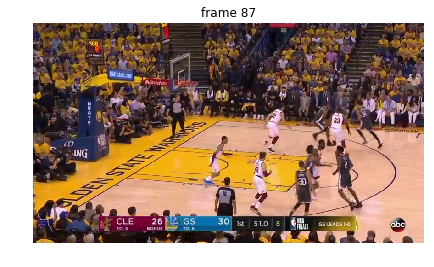

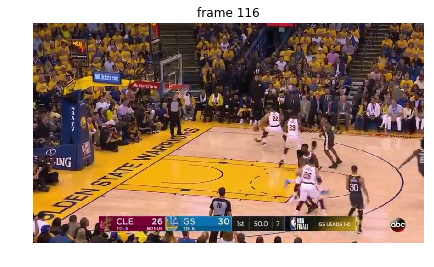

...

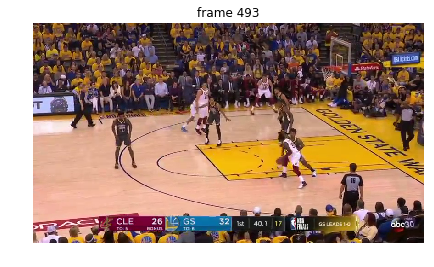

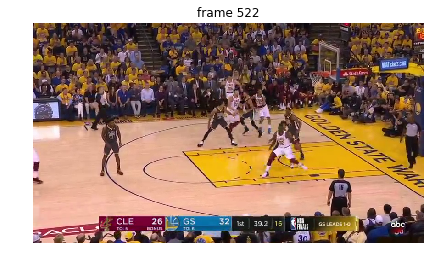

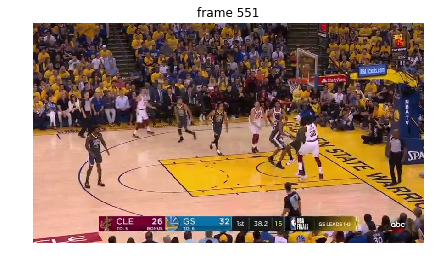

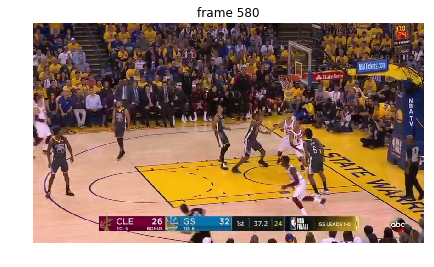

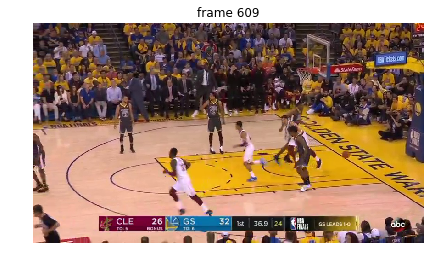

In [20]:
# Re-open the video to now process it from the start.
video_reader = VideoReader()
video_reader.open(vidFname)

# Read a number of video frames (say, the first 10 seconds).
video_fps = video_reader.get_frame_rate()
print(video_fps)
sampling_period = int(1.0 * video_fps)  # One every 3 seconds.
stop_at = int(20.0 * video_fps)  # For the first 10 seconds.
plt.clf()
%matplotlib inline

for frame in video_reader.get_frames():
  index = video_reader.get_current_frame_index()
  if 0 != index % sampling_period:
    continue
  ipynb_show_cv2_image(frame, 'frame %d' % index)
  if index > stop_at:
    break

(480, 852, 3)
(480, 852, 3)


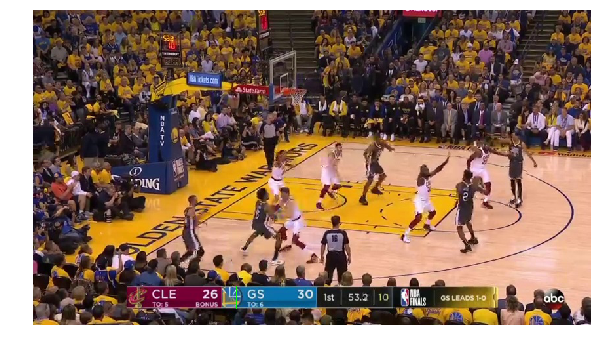

In [5]:
from cvtools import ipynb_show_cv2_image
from cvtools import ipynb_show_matrix

image = cv2.imread('frames/frame0.jpg')
print(np.shape(image))

image_modified = image.copy()
print(np.shape(image_modified))

cv2.rectangle(image_modified, (160, 420), (285, 455), (0, 0, 255))
cv2.rectangle(image_modified, (310, 420), (430, 455), (0, 255, 0))
plt.clf()
ipynb_show_cv2_image(image_modified, figsize=(10, 10))  
plt.show()


In [6]:
def crop_img(image_modified):
    cropRedImg = image_modified[424:444,258:284]
    cropBlueImg = image_modified[424:444,400:429]
    ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
    ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
    return cropRedImg,cropBlueImg

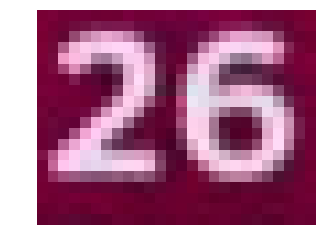

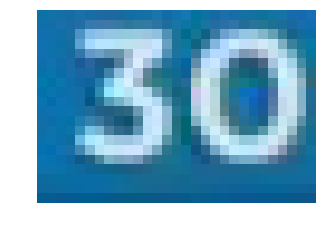

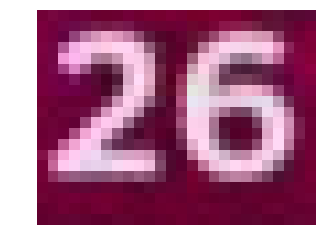

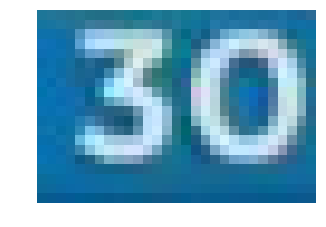

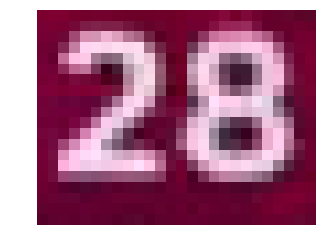

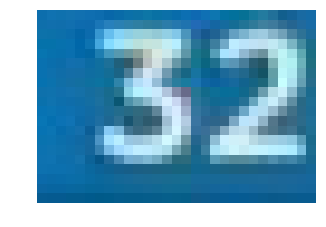

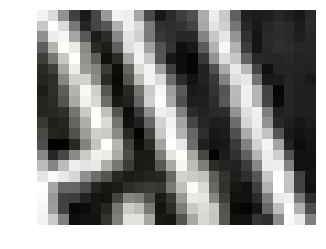

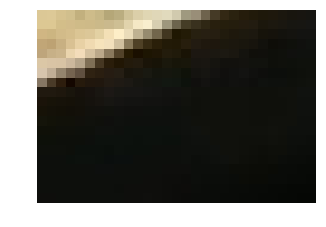

In [7]:
image1 = cv2.imread('frames/frame2.jpg')
image2 = cv2.imread('frames/frame57.jpg')

red0,blue0 = crop_img(image_modified)
red1,blue1 = crop_img(image1)
red2,blue2 = crop_img(image2)

red100,blue100 = crop_img(cv2.imread('frames/frame251.jpg'))

In [ ]:
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist

channel_index=0

error = np.abs(
        red0[:,:,channel_index] - red1[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        red0[:,:,channel_index] - red2[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        red100[:,:,channel_index] - red0[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

######@# blue
print("blue:")
error = np.abs(
        blue0[:,:,channel_index] - blue1[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        blue0[:,:,channel_index] - blue2[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)
ipynb_show_matrix(error, title)

error = np.abs(
        blue100[:,:,channel_index] - blue0[:,:,channel_index])

title = 'error in channel #%d (min: %d, avg: %.1f, max: %d)' % (
    channel_index,np.min(error), np.average(error), np.max(error))
print(title)


### New

In [8]:
def crop_img_to_grey(image_modified):
    cropRedImg = image_modified[424:444,258:284]
    cropBlueImg = image_modified[424:444,400:429]
#     ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
#     ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
    Img_Red = color.rgb2gray(cropRedImg)
    Img_Blue = color.rgb2gray(cropBlueImg)
    return Img_Red,Img_Blue

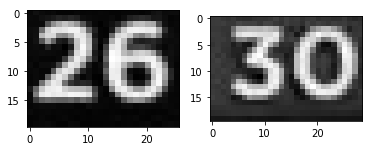

In [9]:
image1 = cv2.imread('frames/frame2.jpg')
red0,blue0 = crop_img_to_grey(image1)
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red0,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue0,cmap='gray')
plt.show()

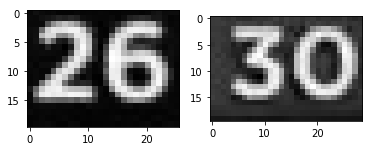

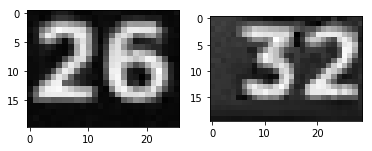

In [10]:
image1 = cv2.imread('frames/frame2.jpg')
image2 = cv2.imread('frames/frame12.jpg')

# red0,blue0 = crop_img_to_grey(image_modified)
red1,blue1 = crop_img_to_grey(image1)
red2,blue2 = crop_img_to_grey(image2)
# plt.figure()
# plt.clf()
# plt.subplot(1, 2, 1)
# plt.imshow(red0,cmap = 'gray')
# plt.subplot(1, 2, 2)
# plt.imshow(blue0,cmap='gray')
# plt.show()

plt.figure()
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red1,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue1,cmap='gray')
plt.show()

plt.figure()
plt.clf()
plt.subplot(1, 2, 1)
plt.imshow(red2,cmap = 'gray')
plt.subplot(1, 2, 2)
plt.imshow(blue2,cmap='gray')
plt.show()



# red100,blue100 = crop_img(cv2.imread('frames/frame251.jpg'))

In [11]:
A = np.array([[1,2,3],[2,1,3]])
B = np.array([[1,1,1],[1,1,1]])
np.sqrt(np.sum(np.square(A-B)))

3.1622776601683795

In [12]:
#abs test
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist
goal = []
prev = 0
curr = 1
for i in np.arange(3,40):
    if prev == 0:
        prev = i-1
        curr = i
#     image1 = cv2.imread('frames/frame'+str(prev)+'.jpg')
#     image2 = cv2.imread('frames/frame'+str(curr)+'.jpg')
    image1 = cv2.imread('frames/frame'+str(i-1)+'.jpg')
    image2 = cv2.imread('frames/frame'+str(i)+'.jpg')
    red0,blue0 = crop_img_to_grey(image1)
    red1,blue1 = crop_img_to_grey(image2)
# red2,blue2 = crop_img_to_grey(image2)

#     error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
#     error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
    error_Red01 = np.sum(np.abs(red0-red1))
    error_Blue01 = np.sum(np.abs(blue0-blue1))
    print('error in grayscale: Red:%.3f , Blue:%.3f'%(error_Red01,error_Blue01))
    if ( (50< error_Red01 < 130) or (50<  error_Blue01 < 130) ) and ((error_Red01 > 50.0 and error_Blue01 > 50.0)==0):
        prev = i
        curr +=1
        goal.append(i)
        
    else:
        curr+=1

print(goal)




error in grayscale: Red:3.035 , Blue:4.798
error in grayscale: Red:13.508 , Blue:13.959
error in grayscale: Red:4.868 , Blue:6.237
error in grayscale: Red:2.681 , Blue:3.125
error in grayscale: Red:4.450 , Blue:3.684
error in grayscale: Red:12.808 , Blue:13.694
error in grayscale: Red:1.709 , Blue:3.292
error in grayscale: Red:2.731 , Blue:2.728
error in grayscale: Red:4.059 , Blue:19.116
error in grayscale: Red:14.409 , Blue:66.414
error in grayscale: Red:5.684 , Blue:7.921
error in grayscale: Red:5.618 , Blue:7.516
error in grayscale: Red:5.057 , Blue:5.353
error in grayscale: Red:5.733 , Blue:6.373
error in grayscale: Red:16.516 , Blue:15.242
error in grayscale: Red:5.596 , Blue:4.893
error in grayscale: Red:4.857 , Blue:6.435
error in grayscale: Red:4.165 , Blue:5.065
error in grayscale: Red:13.709 , Blue:15.324
error in grayscale: Red:4.968 , Blue:4.756
error in grayscale: Red:5.974 , Blue:7.259
error in grayscale: Red:2.482 , Blue:4.609
error in grayscale: Red:14.282 , Blue:14.47

29.999155
1649.5464597753958
259 8.633576499582247
296 9.866944570951139
629 20.96725721327117
666 22.200625284640065
7696 256.5405588447296
7733 257.7739269160985
9398 313.2754901276987
10804 360.1434768397166
13135 437.8456653359568
16872 562.4158405442149
19758 658.6185501109885
19795 659.8519181823575
21386 712.8867452512198
22644 754.8212596777622
23643 788.1221976047223
24420 814.022927103469
28934 964.4938318104739
29600 986.694457095114
29637 987.9278251664829
30340 1011.3618185224918
32153 1071.7968540195675


/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


34003 1133.4652575880123
37629 1254.3353285821636
38184 1272.835849652697
38850 1295.036474937337
38887 1296.269843008706
39294 1309.8368917937637
40922 1364.1050869339952
40959 1365.338455005364
42476 1415.9065459314886
42513 1417.1399140028575
44992 1499.775574784573


/Users/lizy/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:32: DeprecationWarning: generator 'VideoReader.get_frames' raised StopIteration


done
32
[8.633576499582247, 9.866944570951139, 20.96725721327117, 22.200625284640065, 256.5405588447296, 257.7739269160985, 313.2754901276987, 360.1434768397166, 437.8456653359568, 562.4158405442149, 658.6185501109885, 659.8519181823575, 712.8867452512198, 754.8212596777622, 788.1221976047223, 814.022927103469, 964.4938318104739, 986.694457095114, 987.9278251664829, 1011.3618185224918, 1071.7968540195675, 1133.4652575880123, 1254.3353285821636, 1272.835849652697, 1295.036474937337, 1296.269843008706, 1309.8368917937637, 1364.1050869339952, 1365.338455005364, 1415.9065459314886, 1417.1399140028575, 1499.775574784573]


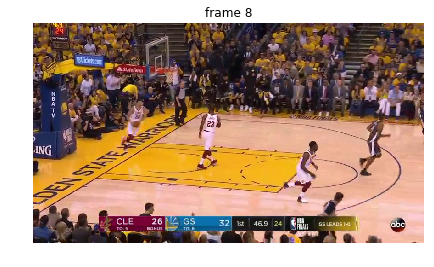

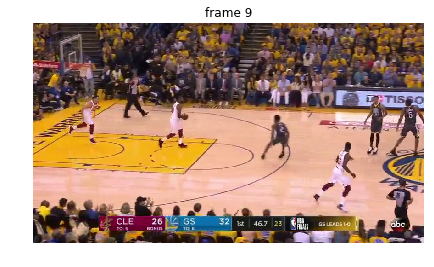

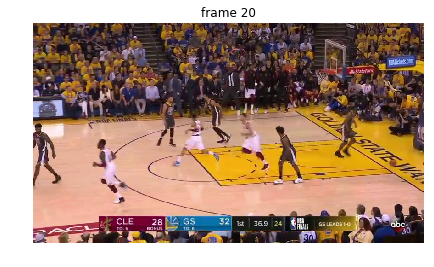

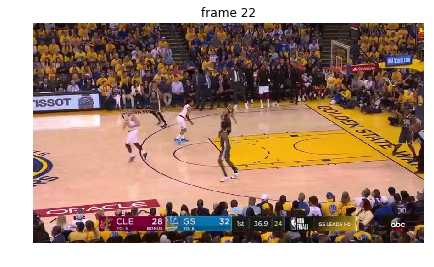

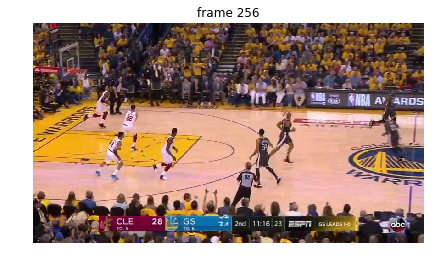

...

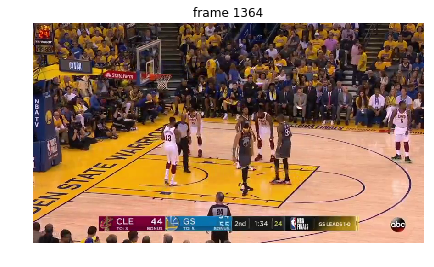

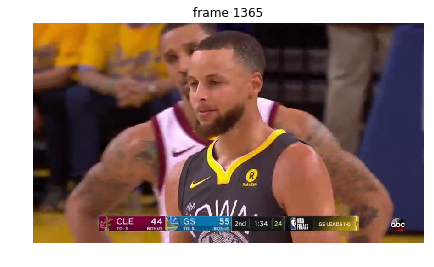

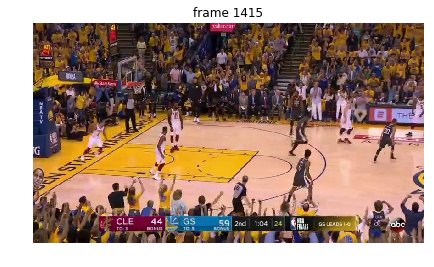

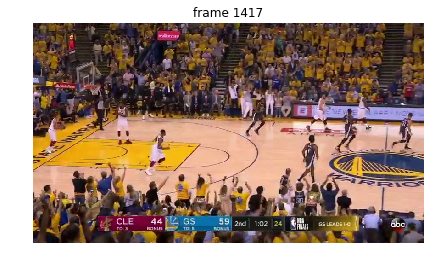

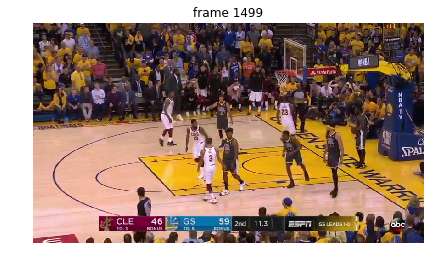

In [42]:
vidFname = 'nba.mp4'
video_reader = VideoReader()
video_reader.open(vidFname)

# Read a number of video frames (say, the first 10 seconds).
video_fps = video_reader.get_frame_rate()
print(video_fps)
sampling_period = int(1 * video_fps)  # One every 3 seconds.
print(video_duration)
stop_at = int(video_duration * video_fps)  # For the first 10 seconds.
plt.clf()
%matplotlib inline


#(480, 852, 3)
vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img_to_grey(image)

# ipynb_show_cv2_image(red0, figsize=(5, 5)) 
# ipynb_show_cv2_image(blue0, figsize=(5, 5)) 
images_red = {}
images_blue = {}
errors_red = {}
errors_blue = {}
highlight = []

for frame in video_reader.get_frames():
    index = video_reader.get_current_frame_index()
    if 0 != index % int(sampling_period*1.3):
        continue
    
    red1,blue1 = crop_img_to_grey(frame)

    error_Red01 = np.sum(np.abs(red0-red1))
    error_Blue01 = np.sum(np.abs(blue0-blue1))
#    if ((error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15)) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
    if ( (50< error_Red01 < 130) or (50<  error_Blue01 < 130) ) and ((error_Red01 > 50.0 and error_Blue01 > 50.0)==0):
        
        red0 = red1
        blue0 = blue1
        count = index/video_fps
        #print(video_fps)
        print(index,count)
        ipynb_show_cv2_image(frame, 'frame %d' % count)
        highlight.append(count)
        images_red[count] = red1
        images_blue[count] = blue1
        errors_red[count] = error_Red01
        errors_blue[count] = error_Blue01
    
    if index > stop_at:
        break

    
print("done")
print(len(highlight))
print(highlight)
    

In [37]:
#abs test
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
fps = vidReader.get(cv2.CAP_PROP_FPS)
print(vidFrames,fps)
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img_to_grey(image)

# ipynb_show_cv2_image(red0, figsize=(5, 5)) 
# ipynb_show_cv2_image(blue0, figsize=(5, 5)) 
images_red = {}
images_blue = {}
errors_red = {}
errors_blue = {}
highlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(39):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        print("break")
        break
    red1,blue1 = crop_img_to_grey(image)
    
    error_Red01 = np.sum(np.abs(red0-red1))
    error_Blue01 = np.sum(np.abs(blue0-blue1))
#     if ((error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15)) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
    if ( (50< error_Red01 < 130) or (50<  error_Blue01 < 130) ) and ((error_Red01 > 50.0 and error_Blue01 > 50.0)==0):
        red0 = red1
        blue0 = blue1
        count = count*40/fps
        highlight.append(float(count))
        images_red[count] = red1
        images_blue[count] = blue1
        errors_red[count] = error_Red01
        errors_blue[count] = error_Blue01
        
print("done")
print(len(highlight))
print(highlight)

49485 29.999154597179764
break
done
31
[9.333596354956047, 260.45213470558195, 403.2808774338136, 584.3909714375972, 856.5454327809473, 1267.429626660624, 1739.2885155280399, 2343.117383305519, 3146.911858012685, 4249.335557359058, 5708.608278930032, 7645.026476138166, 10220.323311189255, 13799.486619082527, 18401.16737206977, 24558.24854984583, 32746.587535042945, 43723.348841471285, 58360.77640079372, 77937.89816502202, 103938.79322499351, 138610.29701785842, 184820.2709430876, 246447.3061657059, 328607.00173047493, 438208.3510598278, 584295.6002513805, 779133.4230549469, 1038875.1730066338, 1385287.2682009574, 1847103.0758062617]


9.866944570951139 14.871156078431373 93.22268156862745


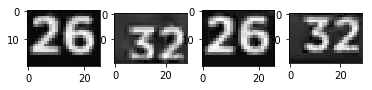

20.96725721327117 104.17052588235295 15.762334901960784


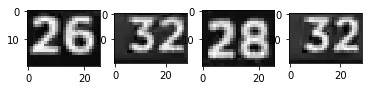

22.200625284640065 92.36839882352942 14.120806274509807


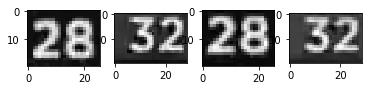

256.5405588447296 16.243096862745098 94.2960494117647


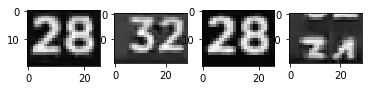

257.7739269160985 2.6843580392156854 98.65588196078431


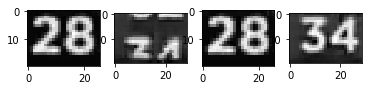

313.2754901276987 92.14977019607844 18.137224705882357


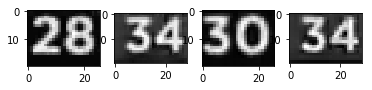

360.1434768397166 17.556432549019608 66.76095607843138


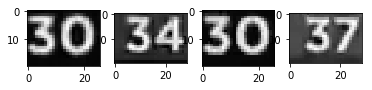

437.8456653359568 12.571683137254903 53.27858901960785


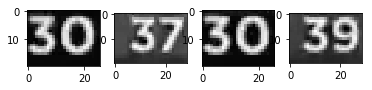

562.4158405442149 91.51413254901962 18.943837647058825


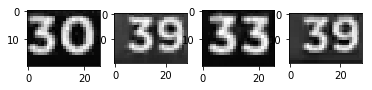

658.6185501109885 15.632148235294117 84.71680078431373


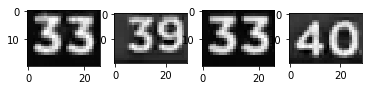

659.8519181823575 1.6241070588235296 63.83791294117647


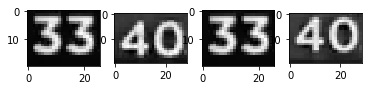

712.8867452512198 54.29741568627452 12.948441960784312


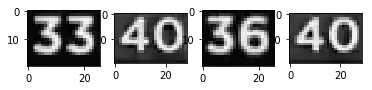

754.8212596777622 14.355377254901962 70.64894039215687


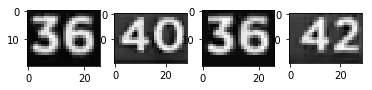

788.1221976047223 13.055476078431372 67.22959137254902


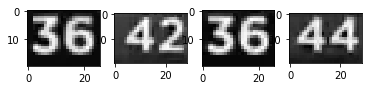

814.022927103469 13.018790196078431 68.34567137254902


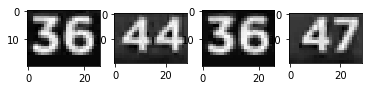

964.4938318104739 46.429827843137254 54.685046666666665


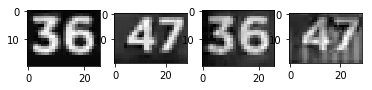

986.694457095114 120.91983490196078 49.63231921568628


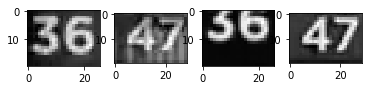

987.9278251664829 97.5101694117647 12.153872941176472


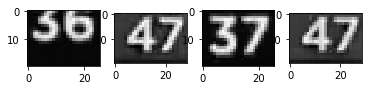

1011.3618185224918 14.434570980392158 54.96834117647058


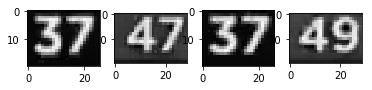

1071.7968540195675 73.3109337254902 15.511925490196072


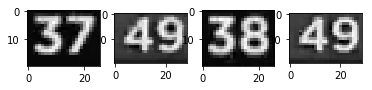

1133.4652575880123 16.530201176470587 75.52404745098039


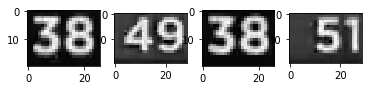

1254.3353285821636 99.43813294117646 14.303703529411766


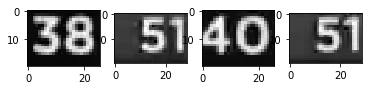

1272.835849652697 98.72054352941177 13.155626666666663


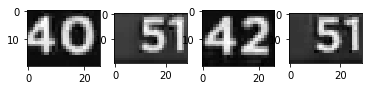

1295.036474937337 97.53465176470588 12.369189019607841


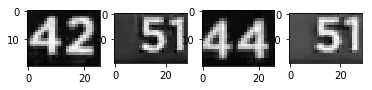

1296.269843008706 70.43309529411766 12.17928784313726


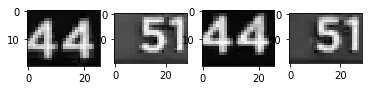

1309.8368917937637 14.058779607843137 85.4788631372549


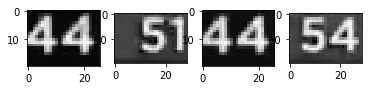

1364.1050869339952 11.820924705882353 89.36742078431374


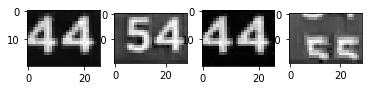

1365.338455005364 11.473534901960786 93.76168549019607


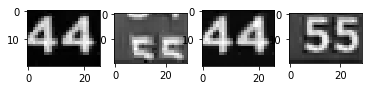

1415.9065459314886 12.206944705882355 75.09806039215687


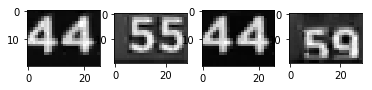

1417.1399140028575 13.12105411764706 83.65278196078432


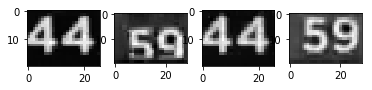

1499.775574784573 65.40645215686274 19.101566666666667


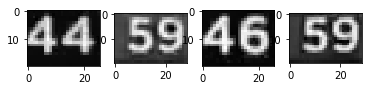

In [44]:
for i in np.arange(0,len(highlight)):
    if i ==0:
        continue
    red1 = images_red[highlight[i-1]]
    blue1 = images_blue[highlight[i-1]]
    red2 = images_red[highlight[i]]
    blue2 = images_blue[highlight[i]]
    print(highlight[i],errors_red[highlight[i]],errors_blue[highlight[i]])
    plt.figure()
    plt.clf()
    plt.subplot(1, 4, 1)
    plt.imshow(red1,cmap = 'gray')
    plt.subplot(1, 4, 2)
    plt.imshow(blue1,cmap='gray')
    plt.subplot(1, 4, 3)
    plt.imshow(red2,cmap = 'gray')
    plt.subplot(1, 4, 4)
    plt.imshow(blue2,cmap='gray')
    plt.show()

In [71]:
import os

h=str(70)
h_i = str(230)
command = "ffmpeg -i nba.mp4 -ss "+h+" -c copy -to "+h_i+" cut.mp4"
os.system(command)
# command


0

In [79]:
highlight2 = [23 ,30 ,35 ,40]

In [86]:
#!ffmpeg -ss 00:01:00 -i nba.mp4 -to 00:02:00 -c copy cut.mp4
import os

name_ = ' video/cut'
for idx,h in enumerate(highlight2[:-1]):
    h=str(int(h))
    file_name = name_+str(idx)+'.mp4'
    h_i = str(int(highlight2[idx+1]))
    command = "ffmpeg -i nba.mp4 -ss "+h+" -c copy -to "+h_i+ file_name
    os.system(command)



In [87]:
command_concat = 'cat video/*.mp4 > video/movie.mp4'
os.system(command_concat)

0

In [51]:
#euclidian
from scipy.spatial.distance import euclidean
from scipy.spatial.distance import pdist
goal = []
prev = 0
curr = 1
for i in np.arange(3,40):
    if prev == 0:
        prev = i-1
        curr = i
    image1 = cv2.imread('frames/frame'+str(prev)+'.jpg')
    image2 = cv2.imread('frames/frame'+str(curr)+'.jpg')
#     print('i:%d'%i)
    red0,blue0 = crop_img_to_grey(image1)
    red1,blue1 = crop_img_to_grey(image2)
# red2,blue2 = crop_img_to_grey(image2)

    error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
    error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
    print('error in grayscale: Red:%.3f , Blue:%.3f'%(error_Red01,error_Blue01))
    if (error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
        prev = i
        curr +=1
        goal.append(i)
        
    else:
        curr+=1

print(goal)



error in grayscale: Red:0.200 , Blue:0.267
error in grayscale: Red:0.808 , Blue:0.783
error in grayscale: Red:0.809 , Blue:0.792
error in grayscale: Red:0.808 , Blue:0.782
error in grayscale: Red:0.804 , Blue:0.768
error in grayscale: Red:0.805 , Blue:0.773
error in grayscale: Red:0.802 , Blue:0.759
error in grayscale: Red:0.772 , Blue:0.739
error in grayscale: Red:0.780 , Blue:1.429
error in grayscale: Red:0.950 , Blue:4.239
error in grayscale: Red:0.399 , Blue:0.576
error in grayscale: Red:0.535 , Blue:0.653
error in grayscale: Red:0.628 , Blue:0.672
error in grayscale: Red:0.613 , Blue:0.768
error in grayscale: Red:0.924 , Blue:1.044
error in grayscale: Red:0.932 , Blue:1.069
error in grayscale: Red:0.843 , Blue:1.074
error in grayscale: Red:0.863 , Blue:1.122
error in grayscale: Red:0.878 , Blue:1.017
error in grayscale: Red:0.857 , Blue:0.970
error in grayscale: Red:0.868 , Blue:0.978
error in grayscale: Red:0.872 , Blue:0.929
error in grayscale: Red:0.936 , Blue:0.901
error in gr

In [43]:
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img_to_grey(image)

# ipynb_show_cv2_image(red0, figsize=(5, 5)) 
# ipynb_show_cv2_image(blue0, figsize=(5, 5)) 
images_red = {}
images_blue = {}
errors_red = {}
errors_blue = {}
highlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(35):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        print("break")
        break
    red1,blue1 = crop_img_to_grey(image)
    
    error_Red01 = np.sqrt(np.sum(np.square(red0-red1)))
    error_Blue01 = np.sqrt(np.sum(np.square(blue0-blue1)))
#     if ((error_Red01 > 3.0 and error_Red01 < 15 ) or ( error_Blue01 > 3.0 and error_Blue01 < 15)) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
    if ( (3< error_Red01 < 10) or (3<  error_Blue01 < 10) ) and ((error_Red01 > 3.0 and error_Blue01 > 3.0)==0):
        red0 = red1
        blue0 = blue1
        highlight.append(count)
        images_red[count] = red1
        images_blue[count] = blue1
        errors_red[count] = error_Red01
        errors_blue[count] = error_Blue01
        
print("done")
print(len(highlight))
print(highlight)

break
done
25
[7, 8, 214, 261, 300, 364, 365, 468, 469, 510, 512, 513, 515, 518, 526, 862, 863, 866, 867, 868, 869, 871, 970, 1002, 1330]


0.9379934463701199 4.838507121546668


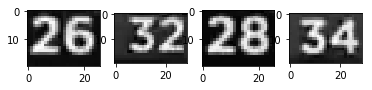

2.409440798342802 4.526554217087302


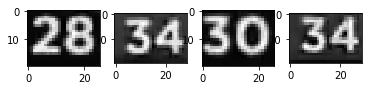

6.4076197859176265 1.940480620705946


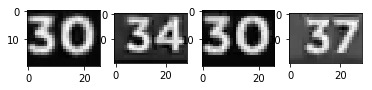

1.1117453876994376 4.428373204583898


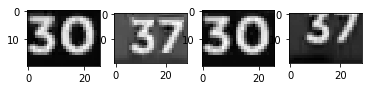

0.7802720263790776 5.087439327168176


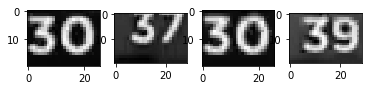

1.0781632499298377 5.594193312369169


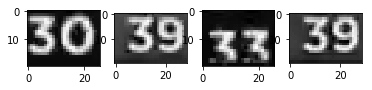

7.899970893853954 0.9955934991573224


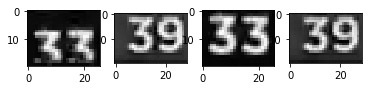

6.9012702911308 0.3360475185561115


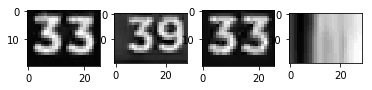

1.399183788660038 5.009388499742775


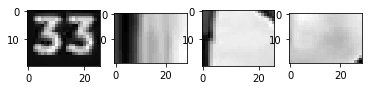

8.914246115292878 2.2738384084069465


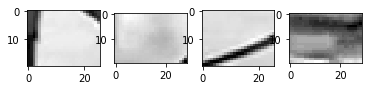

6.079596773498174 2.4133036131907333


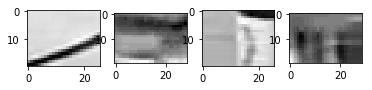

6.088404055953651 1.612088315908009


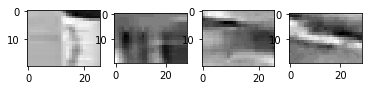

3.9828857126382466 1.357238424640366


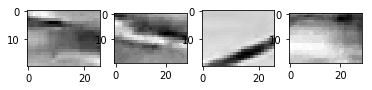

3.5149545973831877 2.437754002966084


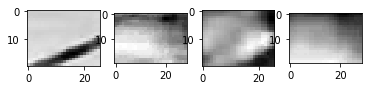

5.279600123200456 2.981132579403598


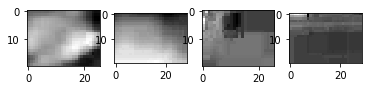

3.0344544807538827 2.4612602537170534


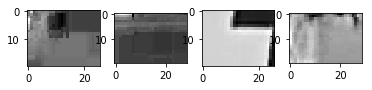

4.193677032008142 0.4625627274814261


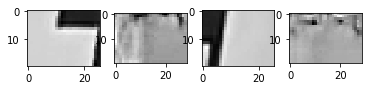

6.165777417434644 0.7510678269057963


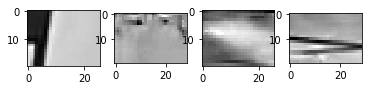

6.425975466702663 2.588221402789549


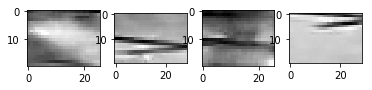

2.7798375817869765 3.7104972110972714


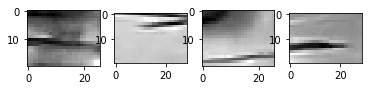

1.5739229250499192 3.4583811556818373


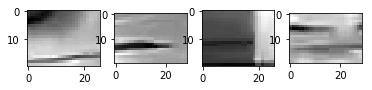

6.156931562885924 2.36232495506048


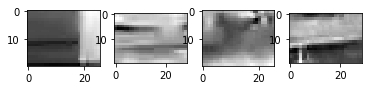

5.906393018500619 2.1310359507755576


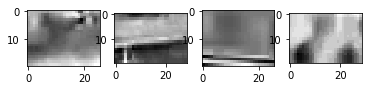

IndexError: list index out of range

In [45]:
for i in np.arange(1,len(highlight)):
    red1 = images_red[highlight[i]]
    blue1 = images_blue[highlight[i]]
    red2 = images_red[highlight[i+1]]
    blue2 = images_blue[highlight[i+1]]
    print(errors_red[highlight[i]],errors_blue[highlight[i]])
    plt.figure()
    plt.clf()
    plt.subplot(1, 4, 1)
    plt.imshow(red1,cmap = 'gray')
    plt.subplot(1, 4, 2)
    plt.imshow(blue1,cmap='gray')
    plt.subplot(1, 4, 3)
    plt.imshow(red2,cmap = 'gray')
    plt.subplot(1, 4, 4)
    plt.imshow(blue2,cmap='gray')
    plt.show()

In [28]:
# def crop_img(image_modified):
#     cropRedImg = image_modified[424:444,258:284]
#     cropBlueImg = image_modified[424:444,400:429]
# #     ipynb_show_cv2_image(cropRedImg, figsize=(5, 5)) 
# #     ipynb_show_cv2_image(cropBlueImg, figsize=(5, 5)) 
#     return cropRedImg,cropBlueImg

/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


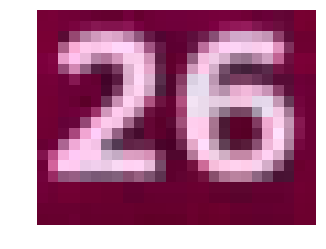

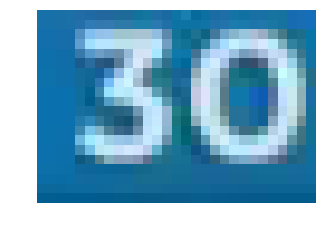

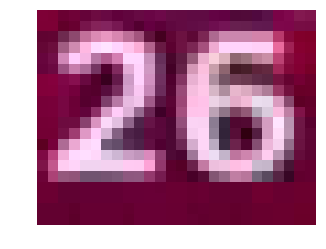

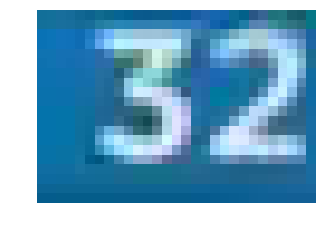

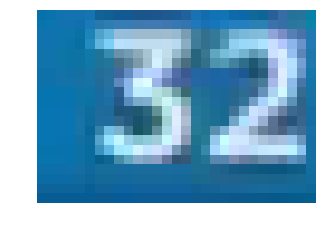

...

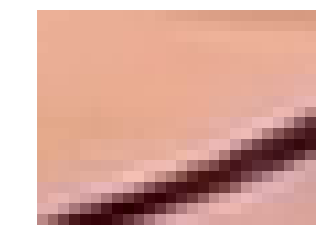

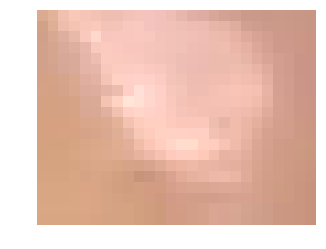

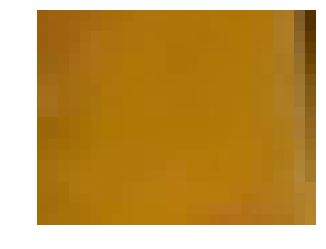

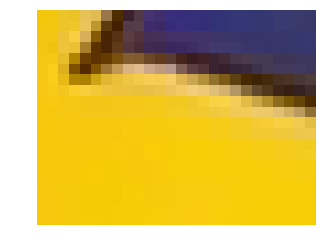

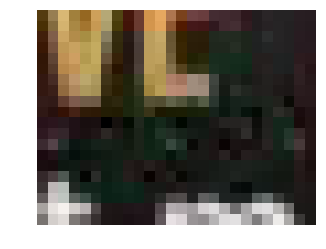

In [119]:
# read vedio and process the img at the same time
# Simple dissimilarity is applied here image-image (pixel by pixel)

vidFname = 'nba.mp4'

vidReader = cv2.VideoCapture(vidFname)
vidFrames = int(vidReader.get(cv2.CAP_PROP_FRAME_COUNT))
#49485 = 35* 23* 60
success,image = vidReader.read()
#(480, 852, 3)

red0,blue0 = crop_img(image)
ipynb_show_cv2_image(red0, figsize=(5, 5)) 
ipynb_show_cv2_image(blue0, figsize=(5, 5)) 

hightlight = []
count = 0
while success:
    # Extracting every 20 frames

    for i in range(20):
        success,image = vidReader.read()
    
    success,image = vidReader.read()
    
    #print('Read a new frame: ', success)
    count += 1
    
    if success == False:
        break
    red1,blue1 = crop_img(image)
    
#     ipynb_show_cv2_image(red1, figsize=(5, 5)) 
#     ipynb_show_cv2_image(blue1, figsize=(5, 5)) 
    
    avg_red = np.average(np.abs(
            red0[:,:,0] - red1[:,:,0]))
    avg_blue = np.average(np.abs(
            blue0[:,:,1] - blue1[:,:,1]))
    #print('err_r: %d, err_b: %d' %(avg_red,avg_blue))
    
#     if (avg_red>= 130 and avg_red < 150):
#         hightlight.append(count)
#         red0,_ = crop_img(image)
#         ipynb_show_cv2_image(red0, figsize=(5, 5)) 
#     if (avg_blue>120 and avg_blue<125):
#         if not count in(hightlight):
#             hightlight.append(count)
#         _,blue0 = crop_img(image)
#         ipynb_show_cv2_image(blue0, figsize=(5, 5)) 

In [120]:
print(len(hightlight))
print(hightlight)

47
[14, 15, 35, 43, 48, 69, 78, 83, 87, 90, 116, 176, 210, 212, 227, 236, 239, 246, 278, 323, 337, 340, 365, 369, 433, 434, 448, 450, 532, 586, 588, 663, 664, 673, 674, 691, 839, 843, 882, 883, 885, 891, 905, 977, 983, 989, 997]


In [79]:
print(avg_red,avg_blue)
print(diff_r,diff_b)

116.56309523809524 101.34777777777778
71.4047619047619 44.473333333333336


14
15
35
43
48
69
78
83
87
90
116
176
210
212
227
236
239
246
278
323
337
340
365
369
433


/Users/lizy/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


434
448
450
532
586
588
663
664
673
674
691
839
843
882
883
885
891
905
977
983
989
997


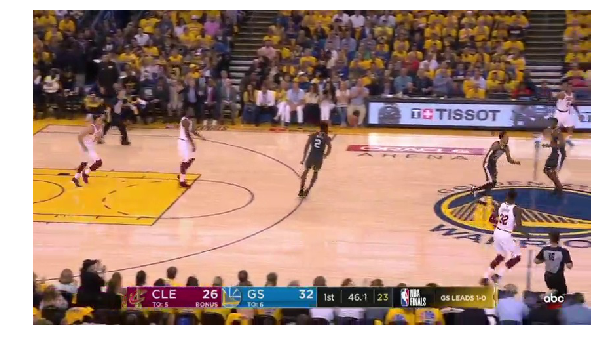

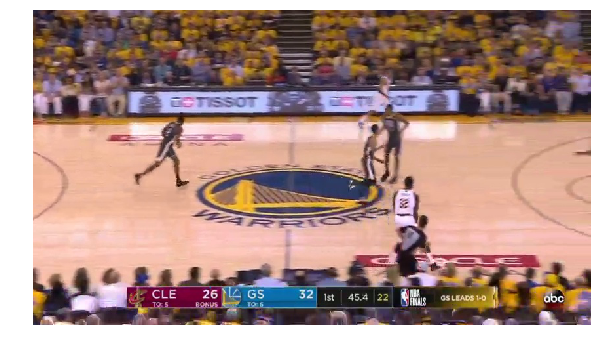

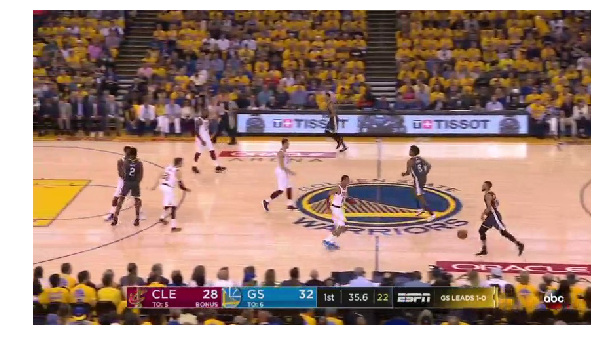

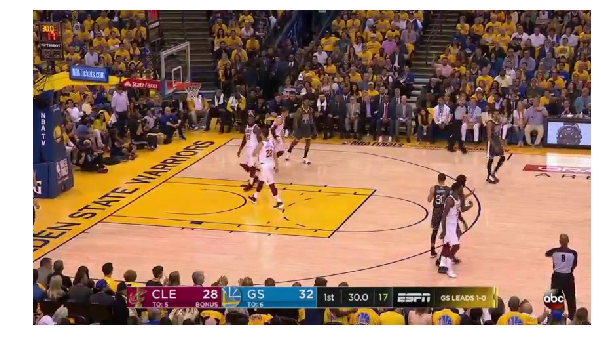

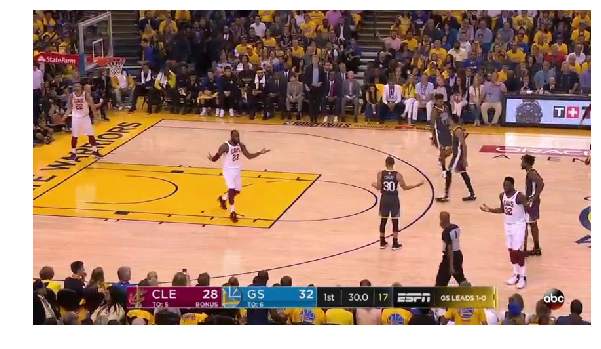

...

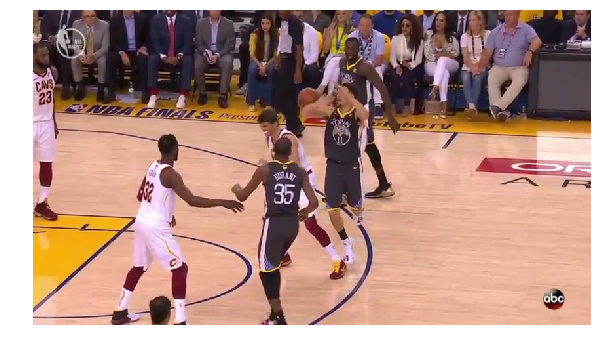

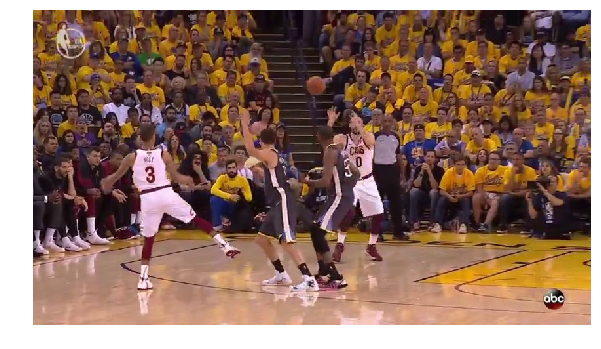

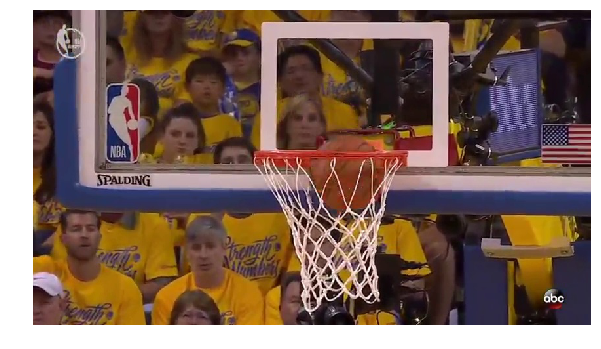

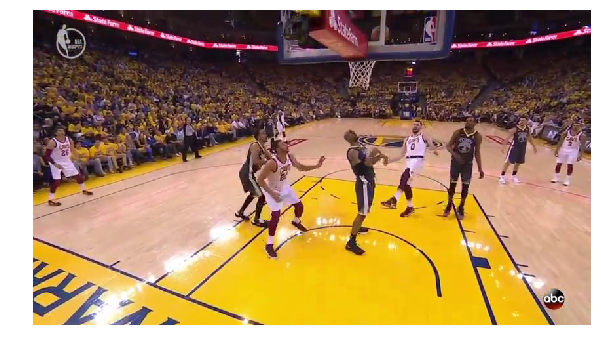

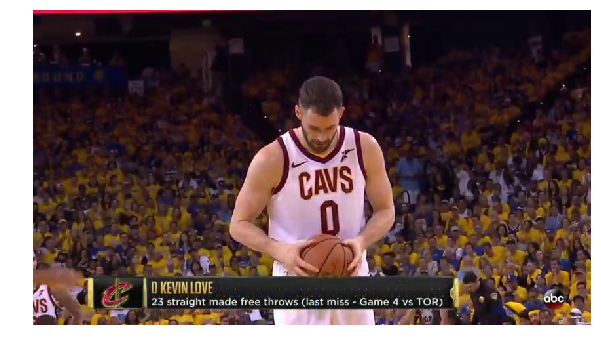

In [121]:
for i in hightlight:
    print(i)
    img = cv2.imread('frames/frame%d.jpg' %(i))
    ipynb_show_cv2_image(img, figsize=(10, 10))